# Author: Vishnu Vardhan Putta

# Notebook 1: Exploratory Data Analysis and Data Cleaning for Smoking Prediction 🚬

## Problem Statement

Smoking is a major public health concern that contributes to numerous diseases, including cancer, cardiovascular diseases, and respiratory disorders. Early detection and intervention for smoking habits can significantly reduce health risks and healthcare costs. However, self-reported smoking status can be unreliable due to social stigma and other factors.

**The Challenge**: To develop a classification model that can accurately predict an individual's smoking status (smoker or non-smoker) based on their health indicators and biological signals.

**Real-World Applications**:
1. **Healthcare Screening**: Assist healthcare providers in identifying potential smokers who might not disclose their habit
2. **Insurance Risk Assessment**: Help insurance companies better assess health risks and premiums
3. **Public Health Research**: Enable researchers to study the physiological effects of smoking across large populations
4. **Preventive Care**: Aid in developing targeted interventions for at-risk individuals
5. **Policy Development**: Support evidence-based policies by providing accurate data on smoking prevalence

In this notebook, we'll perform exploratory data analysis and data cleaning on a comprehensive health dataset to prepare it for building machine learning models to predict smoking status. The cleaned data will be used in subsequent notebooks for model development and evaluation.

## Dataset Description

This notebook explores a comprehensive health biological signals dataset that can be used to predict smoking status based on various health indicators. The dataset has a Kaggle usability score of 7.06.

### Dataset Overview
- **Source**: Kaggle - Body Signal of Smoking Dataset
- **URL**: https://www.kaggle.com/datasets/kukuroo3/body-signal-of-smoking/data
- **Size**: 55,692 records with 27 features
- **Objective**: Determine the presence or absence of smoking through biological signals
- **Target Variable**: "smoking" (Binary: 0 = Non-smoker, 1 = Smoker)

### Features Description
The dataset contains the following features:
- **ID**: Index identifier (not useful for modeling)
- **gender**: Gender of the individual
- **age**: Age in 5-year gaps
- **height(cm)**: Height in centimeters
- **weight(kg)**: Weight in kilograms
- **waist(cm)**: Waist circumference length in centimeters
- **eyesight(left)**: Left eye vision measurement
- **eyesight(right)**: Right eye vision measurement
- **hearing(left)**: Left ear hearing status (1 = normal, 2 = abnormal)
- **hearing(right)**: Right ear hearing status (1 = normal, 2 = abnormal)
- **systolic**: Systolic blood pressure
- **relaxation**: Relaxation (diastolic) blood pressure
- **fasting blood sugar**: Blood sugar level after fasting
- **Cholesterol**: Total cholesterol level
- **triglyceride**: Triglyceride level
- **HDL**: High-density lipoprotein cholesterol level ("good" cholesterol)
- **LDL**: Low-density lipoprotein cholesterol level ("bad" cholesterol)
- **hemoglobin**: Hemoglobin level
- **Urine protein**: Protein level in urine
- **serum creatinine**: Serum creatinine level
- **AST**: Aspartate aminotransferase level (liver enzyme)
- **ALT**: Alanine aminotransferase level (liver enzyme)
- **Gtp**: Gamma-glutamyl transferase level (liver enzyme)
- **oral**: Oral examination status (all records are the same value)
- **dental caries**: Dental cavity status
- **tartar**: Tartar status
- **smoking**: Target variable (0 = Non-smoker, 1 = Smoker)

## 1. Import Required Libraries

First, we'll import the necessary libraries for data manipulation, visualization, and analysis:

In [1]:
# Basic data manipulation and visualization libraries
import numpy as np                 # For numerical operations
import pandas as pd                # For data manipulation and analysis
import matplotlib.pyplot as plt    # For basic plotting
import seaborn as sns              # For advanced visualizations
from collections import Counter    # For counting occurrences

# For feature preprocessing
from sklearn.preprocessing import LabelEncoder

# For data profiling
try:
    from ydata_profiling import ProfileReport
except ImportError:
    # If ydata_profiling is not installed, suggest installation
    print("Please install ydata_profiling with: pip install ydata-profiling")

# For model feature analysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Set Pandas display options to show all columns
pd.set_option('display.max_columns', None)

# Set up visualization style
sns.set(style="whitegrid")  # Add a grid to plots
plt.rcParams['figure.figsize'] = (12, 8)  # Set default figure size

# For reproducibility
import warnings
warnings.filterwarnings('ignore')  # Suppress warnings for cleaner notebook output
RANDOM_STATE = 42  # Fixed random state for reproducibility

## 2. Load and Examine the Dataset

We'll begin by loading the dataset and examining its structure:

In [2]:
# Load the dataset
df = pd.read_csv("smoking.csv")

# Display the first five rows of the dataset
print("First 5 rows of the dataset:")
df.head()

First 5 rows of the dataset:


,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0


In [3]:
# Get basic dataset information
print(f"Dataset shape: {df.shape[0]} rows and {df.shape[1]} columns")
print("\nColumn data types and non-null counts:")
df.info()

Dataset shape: 55692 rows and 27 columns

Column data types and non-null counts:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55692 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   55692 non-null  int64  
 1   gender               55692 non-null  object 
 2   age                  55692 non-null  int64  
 3   height(cm)           55692 non-null  int64  
 4   weight(kg)           55692 non-null  int64  
 5   waist(cm)            55692 non-null  float64
 6   eyesight(left)       55692 non-null  float64
 7   eyesight(right)      55692 non-null  float64
 8   hearing(left)        55692 non-null  float64
 9   hearing(right)       55692 non-null  float64
 10  systolic             55692 non-null  float64
 11  relaxation           55692 non-null  float64
 12  fasting blood sugar  55692 non-null  float64
 13  Cholesterol          55692 non-null  float64
 14  trigl

### 2.1 Rename Columns for Better Readability

The column names contain special characters like parentheses, which can make them difficult to work with. Let's rename them to more code-friendly names in snake_case format:

In [4]:
# Rename columns to be more code-friendly (snake_case format)
df.rename(columns = {
    "height(cm)" : "height_cm", 
    "weight(kg)" : "weight_kg",
    "waist(cm)" : "waist_cm", 
    "eyesight(left)" : "eyesight_left",
    "eyesight(right)" : "eyesight_right", 
    "hearing(left)" : "hearing_left",
    "hearing(right)" : "hearing_right", 
    "fasting blood sugar" : "fasting_blood_sugar",
    "Cholesterol" : "cholesterol", 
    "HDL" : "hdl", 
    "LDL" : "ldl",
    "Urine protein" : "urine_protein", 
    "serum creatinine" : "serum_creatinine",
    "AST" : "ast", 
    "ALT" : "alt", 
    "Gtp" : "gtp", 
    "dental caries" : "dental_caries"
}, inplace=True)

# Verify the renamed columns
print("Renamed columns:", df.columns.tolist())

Renamed columns: ['ID', 'gender', 'age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left', 'eyesight_right', 'hearing_left', 'hearing_right', 'systolic', 'relaxation', 'fasting_blood_sugar', 'cholesterol', 'triglyceride', 'hdl', 'ldl', 'hemoglobin', 'urine_protein', 'serum_creatinine', 'ast', 'alt', 'gtp', 'oral', 'dental_caries', 'tartar', 'smoking']


## 3. Categorical Variable Encoding

Some features in the dataset are categorical. We need to encode these features to convert them into a numerical format that machine learning models can use. We'll use Label Encoding, which assigns a unique integer to each category.

In [5]:
# Identify categorical columns (those with 'object' data type)
categorical_cols = df.select_dtypes(include=['object']).columns.tolist()
print(f"Categorical columns to encode: {categorical_cols}")

# Encode each categorical column
label_encoder = LabelEncoder()
for col in categorical_cols:
    # Display unique values before encoding
    print(f"\nEncoding column: {col}")
    print(f"Unique values before encoding: {df[col].unique()}")
    
    # Apply label encoding
    df[col] = label_encoder.fit_transform(df[col])
    
    # Display unique values after encoding
    print(f"Unique values after encoding: {df[col].unique()}")
    
    # If column is gender, clarify the encoding
    if col == 'gender':
        mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
        print(f"Gender encoding mapping: {mapping}")

Categorical columns to encode: ['gender', 'oral', 'tartar']

Encoding column: gender
Unique values before encoding: ['F' 'M']
Unique values after encoding: [0 1]
Gender encoding mapping: {'F': 0, 'M': 1}

Encoding column: oral
Unique values before encoding: ['Y']
Unique values after encoding: [0]

Encoding column: tartar
Unique values before encoding: ['Y' 'N']
Unique values after encoding: [1 0]


## 4. Data Cleaning and Preprocessing

Next, we'll perform several data cleaning steps to prepare our dataset for modeling.

### 4.1 Remove Unnecessary Features

First, let's identify and remove features that don't contribute to prediction:

In [6]:
# Remove ID column as it's just an index and doesn't provide predictive value
df = df.drop('ID', axis=1)
print("Removed ID column from the dataset.")

# Check the number of unique values in each column to identify potential constant columns
unique_values = df.nunique().sort_values()
print("\nNumber of unique values per column:")
print(unique_values)

Removed ID column from the dataset.

Number of unique values per column:
oral                     1
gender                   2
dental_caries            2
tartar                   2
hearing_right            2
hearing_left             2
smoking                  2
urine_protein            6
height_cm               13
age                     14
eyesight_right          17
eyesight_left           19
weight_kg               22
serum_creatinine        38
relaxation              95
hdl                    126
systolic               130
hemoglobin             145
ast                    219
alt                    245
fasting_blood_sugar    276
cholesterol            286
ldl                    289
triglyceride           390
gtp                    488
waist_cm               566
dtype: int64


In [7]:
# Remove 'oral' column as it has only one unique value (constant)
# A constant column provides no discriminatory information for prediction
df = df.drop('oral', axis=1)
print(f"Removed 'oral' column (constant value) from the dataset.")
print(f"Dataset shape after removing unnecessary columns: {df.shape}")

Removed 'oral' column (constant value) from the dataset.
Dataset shape after removing unnecessary columns: (55692, 25)


### 4.2 Check for Duplicate Records

Duplicate records can bias our model and affect performance. Let's identify and remove them:

In [8]:
# Check for duplicate rows
duplicates_count = df.duplicated().sum()
print(f"Total number of duplicate rows: {duplicates_count}")

# Remove duplicates if they exist
if duplicates_count > 0:
    df.drop_duplicates(inplace=True)
    print(f"Dataset shape after removing duplicates: {df.shape}")
    print(f"Removed {duplicates_count} duplicate rows, which is {duplicates_count/df.shape[0]*100:.2f}% of the original data.")
else:
    print("No duplicate rows found in the dataset.")

Total number of duplicate rows: 11140
Dataset shape after removing duplicates: (44552, 25)
Removed 11140 duplicate rows, which is 25.00% of the original data.


### 4.3 Check for Missing Values

Missing values can cause problems in analysis and modeling. Let's check if our dataset has any:

In [9]:
# Check for missing values
missing_values = df.isnull().sum()
missing_percent = (missing_values / len(df)) * 100

# Create a DataFrame to display missing values information
missing_info = pd.DataFrame({
    'Missing Values': missing_values,
    'Percentage (%)': missing_percent
})

# Display only columns with missing values, if any
missing_columns = missing_info[missing_info['Missing Values'] > 0]
if not missing_columns.empty:
    print("Columns with missing values:")
    print(missing_columns)
else:
    print("No missing values found in the dataset. This is good news for our analysis!")

No missing values found in the dataset. This is good news for our analysis!


## 5. Exploratory Data Analysis (EDA)

Now that we've cleaned our data, let's explore it to gain insights about patterns, relationships, and distributions.

### 5.1 Target Variable Analysis

First, let's examine our target variable (smoking status) to understand the class distribution:

In [10]:
# Check the distribution of the target variable
smoking_counts = df['smoking'].value_counts()
smoking_percent = (smoking_counts / len(df)) * 100

# Display counts and percentages
print("Target Variable Distribution:")
print("\nCounts:")
print(smoking_counts)
print("\nPercentages:")
print(smoking_percent)

Target Variable Distribution:

Counts:
smoking
0    28200
1    16352
Name: count, dtype: int64

Percentages:
smoking
0    63.296822
1    36.703178
Name: count, dtype: float64


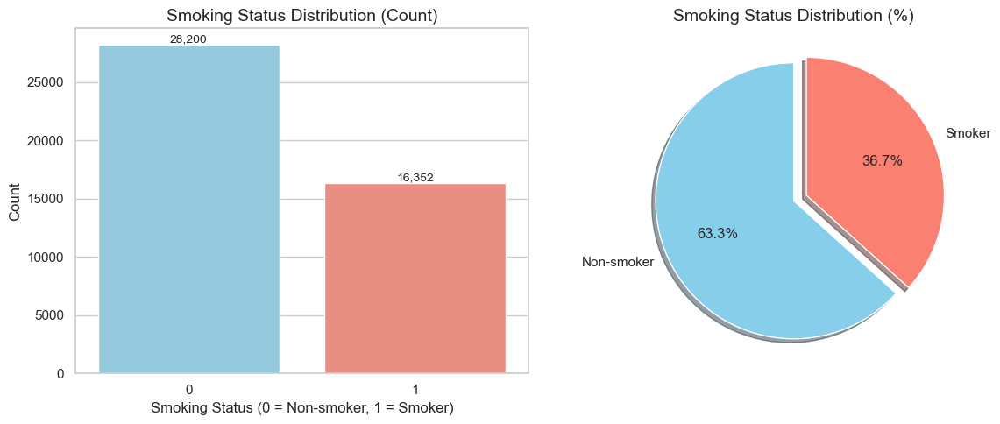

In [11]:
# Visualize the target variable distribution
plt.figure(figsize=(12, 5))

# Create subplot for count plot
plt.subplot(1, 2, 1)
ax = sns.countplot(x='smoking', data=df, palette=['skyblue', 'salmon'])
plt.title('Smoking Status Distribution (Count)', fontsize=14)
plt.xlabel('Smoking Status (0 = Non-smoker, 1 = Smoker)', fontsize=12)
plt.ylabel('Count', fontsize=12)
# Add counts on top of bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_height()):,}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', fontsize=10)

# Create subplot for pie chart
plt.subplot(1, 2, 2)
labels = ['Non-smoker', 'Smoker']
plt.pie(smoking_counts, labels=labels, autopct='%1.1f%%', colors=['skyblue', 'salmon'], 
        explode=[0, 0.1], shadow=True, startangle=90)
plt.title('Smoking Status Distribution (%)', fontsize=14)

plt.tight_layout()
plt.show()

**Observation about Class Imbalance:**

The dataset shows a moderate class imbalance with approximately 63% non-smokers and 37% smokers. This imbalance is important to note but not severe enough to require advanced resampling techniques. In general:

- A 60:40 or 70:30 split is considered a mild imbalance
- An 80:20 split is considered a moderate imbalance
- A 90:10 or more extreme split is considered a severe imbalance

With our distribution, we'll need to be cautious when evaluating model performance. Instead of just accuracy, we'll need to consider precision, recall, F1-score, and ROC-AUC as evaluation metrics to get a complete picture of model performance across both classes.

### 5.2 Numerical Feature Distribution

Let's examine the distribution of numerical features to understand their characteristics:

In [12]:
# Get summary statistics of numerical features
print("Summary Statistics of Numerical Features:")
df.describe()

Summary Statistics of Numerical Features:


,gender,age,height_cm,weight_kg,waist_cm,eyesight_left,eyesight_right,hearing_left,hearing_right,systolic,relaxation,fasting_blood_sugar,cholesterol,triglyceride,hdl,ldl,hemoglobin,urine_protein,serum_creatinine,ast,alt,gtp,dental_caries,tartar,smoking
count,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000,44552.000000
mean,0.636313,44.210698,164.657030,65.883462,82.077186,1.011730,1.008130,1.025611,1.026037,121.529179,76.043320,99.320210,196.996005,126.722257,57.288382,115.037978,14.622235,1.087022,0.886104,26.213795,27.085002,40.066103,0.213526,0.555778,0.367032
std,0.481066,12.089196,9.198674,12.823819,9.278384,0.488136,0.488767,0.157972,0.159247,13.688876,9.695356,20.845547,36.423237,71.612721,14.795399,40.938284,1.564866,0.404948,0.226090,19.087304,31.755110,50.723940,0.409800,0.496885,0.482001
min,0.000000,20.000000,130.000000,30.000000,51.000000,0.100000,0.100000,1.000000,1.000000,71.000000,40.000000,46.000000,55.000000,8.000000,4.000000,1.000000,4.900000,1.000000,0.100000,6.000000,1.000000,1.000000,0.000000,0.000000,0.000000
25%,0.000000,40.000000,160.000000,55.000000,76.000000,0.800000,0.800000,1.000000,1.000000,112.000000,70.000000,89.000000,172.000000,74.000000,47.000000,92.000000,13.600000,1.000000,0.800000,19.000000,15.000000,17.000000,0.000000,0.000000,0.000000
50%,1.000000,40.000000,165.000000,65.000000,82.000000,1.000000,1.000000,1.000000,1.000000,120.000000,76.000000,96.000000,195.000000,108.000000,55.000000,113.000000,14.800000,1.000000,0.900000,23.000000,21.000000,26.000000,0.000000,1.000000,0.000000
75%,1.000000,55.000000,170.000000,75.000000,88.000000,1.200000,1.200000,1.000000,1.000000,130.000000,82.000000,104.000000,220.000000,160.000000,66.000000,136.000000,15.700000,1.000000,1.000000,29.000000,31.000000,44.000000,0.000000,1.000000,1.000000
max,1.000000,85.000000,190.000000,135.000000,129.000000,9.900000,9.900000,2.000000,2.000000,240.000000,146.000000,505.000000,445.000000,999.000000,618.000000,1860.000000,21.100000,6.000000,11.600000,1311.000000,2914.000000,999.000000,1.000000,1.000000,1.000000


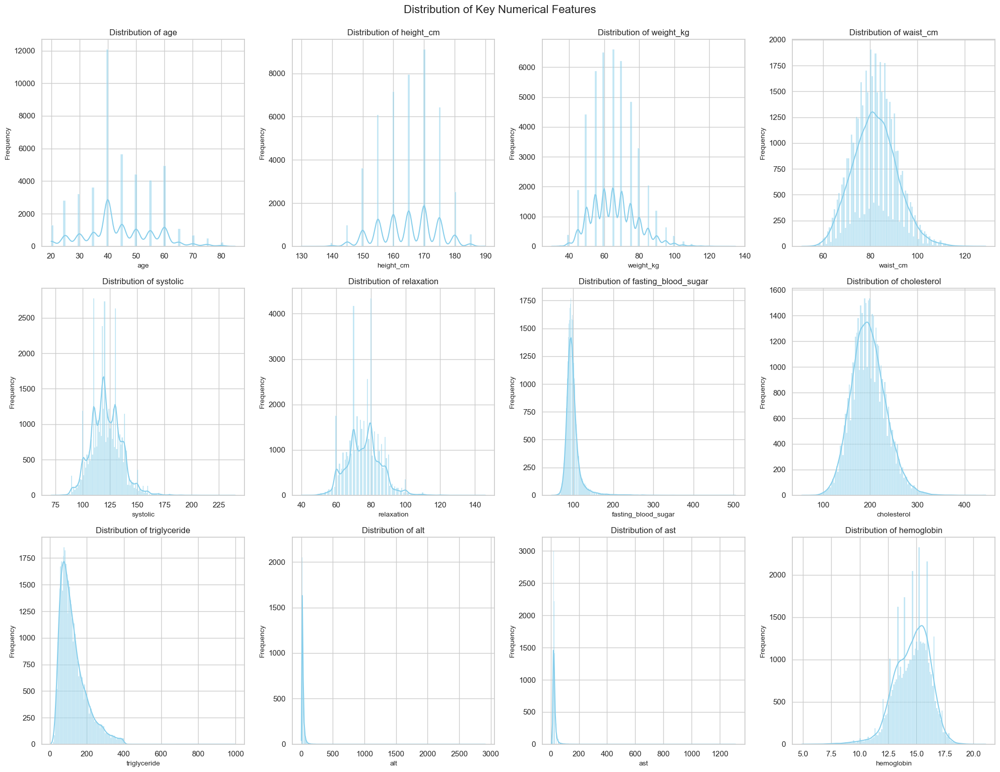

In [13]:
# Plot histograms to visualize the distribution of numerical features
# Select a subset of important numerical features for clearer visualization
important_num_features = ['age', 'height_cm', 'weight_kg', 'waist_cm', 'systolic', 'relaxation', 
                          'fasting_blood_sugar', 'cholesterol', 'triglyceride', 'alt', 'ast', 'hemoglobin']

# Create a grid of histograms
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for i, feature in enumerate(important_num_features):
    ax = axes[i]
    sns.histplot(df[feature], kde=True, ax=ax, color='skyblue')
    ax.set_title(f'Distribution of {feature}', fontsize=12)
    ax.set_xlabel(feature, fontsize=10)
    ax.set_ylabel('Frequency', fontsize=10)
    
plt.tight_layout()
plt.suptitle('Distribution of Key Numerical Features', fontsize=16, y=1.02)
plt.show()

**Observations from Numerical Features:**

1. Most features show approximately normal distributions with some skewness.
2. Features like `triglyceride`, `alt`, and `ast` appear to be right-skewed, which may indicate the presence of outliers.
3. Some features have clearly defined ranges that make sense physiologically (e.g., blood pressure, blood sugar, cholesterol levels).
4. The distribution of `height_cm` shows two peaks, which likely corresponds to the gender differences in height.

These observations will help us decide on appropriate preprocessing steps like scaling and outlier handling.

### 5.3 Correlation Analysis

Let's analyze correlations between features to understand relationships and potential predictors of smoking status:

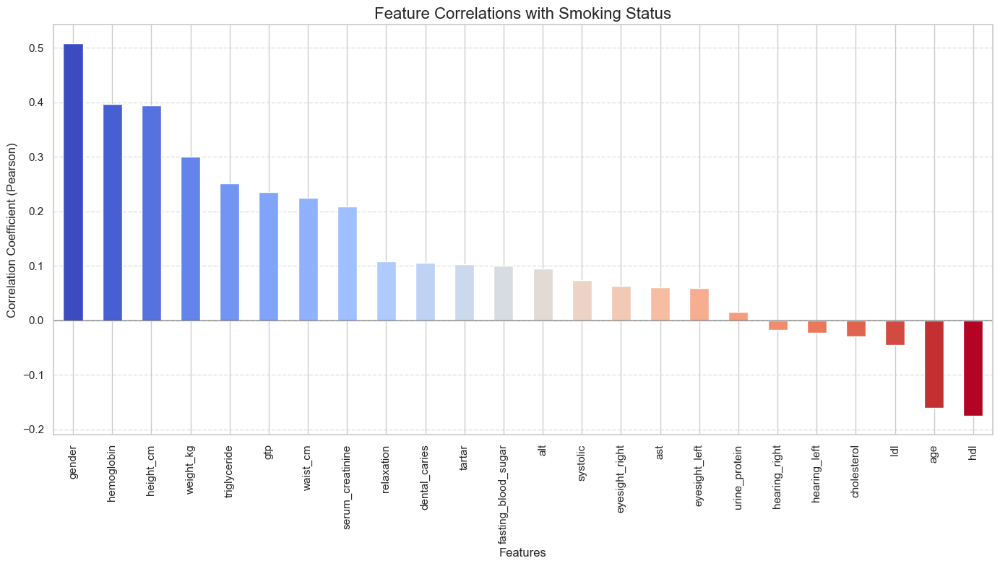

Top 5 Positive Correlations with Smoking:
gender          0.507735
hemoglobin      0.397289
height_cm       0.393706
weight_kg       0.299443
triglyceride    0.250896
Name: smoking, dtype: float64

Top 5 Negative Correlations with Smoking:
hearing_left   -0.023519
cholesterol    -0.030187
ldl            -0.045016
age            -0.161127
hdl            -0.175895
Name: smoking, dtype: float64


In [14]:
# Calculate the correlation matrix
corr_matrix = df.corr(method='pearson')  # Pearson correlation coefficient

# Calculate correlations with the target variable
target_correlations = corr_matrix['smoking'].drop('smoking').sort_values(ascending=False)

# Create a bar plot of correlations with the target
plt.figure(figsize=(14, 8))
target_correlations.plot(kind='bar', color=plt.cm.coolwarm(np.linspace(0, 1, len(target_correlations))))

plt.title('Feature Correlations with Smoking Status', fontsize=16)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Correlation Coefficient (Pearson)', fontsize=12)
plt.axhline(y=0, color='black', linestyle='-', alpha=0.3)  # Add a horizontal line at y=0
plt.xticks(rotation=90)  # Rotate x labels for better readability
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# Display the top positive and negative correlations
print("Top 5 Positive Correlations with Smoking:")
print(target_correlations.head(5))
print("\nTop 5 Negative Correlations with Smoking:")
print(target_correlations.tail(5))

**Observations from Correlation Analysis:**

1. **Strongest Positive Correlations with Smoking:**
   - Gender: This suggests a strong relationship between gender and smoking status, with one gender more likely to smoke than the other.
   - Hemoglobin: Higher hemoglobin levels are associated with smoking, which aligns with the physiological effect of smoking on oxygen-carrying capacity.
   - Height: Taller individuals show a higher correlation with smoking, which might be related to gender differences.
   - Weight: Heavier individuals show some correlation with smoking.
   - Triglyceride: Higher triglyceride levels correlate with smoking, consistent with smoking's known effects on lipid profiles.

2. **Strongest Negative Correlations with Smoking:**
   - HDL (good cholesterol): Lower HDL levels correlate with smoking, which matches clinical findings about smoking's negative effect on healthy cholesterol.
   - Age: Younger individuals in the dataset appear more likely to smoke.
   - LDL: There's a negative correlation with LDL cholesterol.
   - Cholesterol: Total cholesterol shows a weak negative correlation with smoking.
   - Hearing (left/right): There's a weak negative correlation with hearing status.

These correlations provide initial insights into which features might be most predictive of smoking status and align with medical knowledge about smoking's physiological effects.

### 5.4 Feature Relationships by Smoking Status

Let's visualize how some key features differ between smokers and non-smokers:

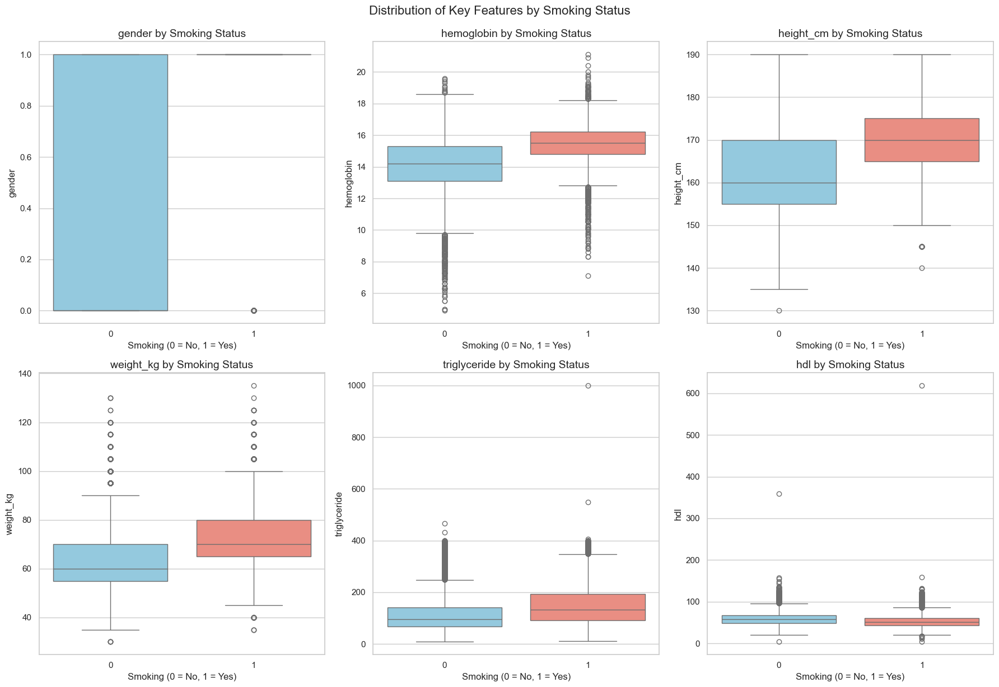

In [15]:
# Select top correlated features
top_features = ['gender', 'hemoglobin', 'height_cm', 'weight_kg', 'triglyceride', 'hdl']

# Create boxplots to compare these features between smokers and non-smokers
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

for i, feature in enumerate(top_features):
    sns.boxplot(x='smoking', y=feature, data=df, ax=axes[i], palette=['skyblue', 'salmon'])
    axes[i].set_title(f'{feature} by Smoking Status', fontsize=14)
    axes[i].set_xlabel('Smoking (0 = No, 1 = Yes)', fontsize=12)
    axes[i].set_ylabel(feature, fontsize=12)
    
plt.tight_layout()
plt.suptitle('Distribution of Key Features by Smoking Status', fontsize=16, y=1.02)
plt.show()

**Observations from Feature Distributions by Smoking Status:**

1. **Gender:** There's a clear difference in the distribution of gender between smokers and non-smokers, confirming our correlation findings.

2. **Hemoglobin:** Smokers tend to have higher hemoglobin levels compared to non-smokers. This is physiologically expected as smoking increases carbon monoxide in the blood, leading to reduced oxygen delivery capacity, which the body compensates for by producing more hemoglobin.

3. **Height/Weight:** Both height and weight show differences between smokers and non-smokers, with smokers generally being taller and heavier. This might be partly due to the gender effect we observed.

4. **Triglycerides:** Smokers tend to have higher triglyceride levels, which aligns with medical research showing smoking's negative impact on lipid profiles.

5. **HDL (Good Cholesterol):** Non-smokers tend to have higher HDL levels than smokers, which is consistent with the known negative effects of smoking on heart health and cholesterol profiles.

These visualizations provide strong evidence that biological markers differ significantly between smokers and non-smokers, suggesting they can be useful predictors in our classification models.

## 6. Outlier Detection and Removal

Outliers can negatively impact model performance. Let's detect and remove them using the Interquartile Range (IQR) method:

In [16]:
def outlier_detection(df, n, columns):
    """
    Detect outliers using the IQR method and return indices of rows to drop.
    
    Parameters:
    - df: DataFrame containing the dataset
    - n: Minimum number of columns a row must be an outlier in to be dropped
    - columns: List of column names to check for outliers
    
    Returns:
    - List of row indices to drop
    """
    # Initialize an empty list to store outlier row indices
    outlier_indices = []
    will_drop = []
    
    # For each column, detect outliers using IQR method
    for col in columns:
        # Calculate Q1 (25th percentile) and Q3 (75th percentile)
        Q1 = np.nanpercentile(df[col], 25)
        Q3 = np.nanpercentile(df[col], 75)
        
        # Calculate IQR (Interquartile Range)
        IQR = Q3 - Q1
        
        # Define outlier step (typically 1.5 times IQR)
        outlier_step = 1.5 * IQR
        
        # Get indices of rows with outliers in this column
        outlier_indices.extend(df[(df[col] < Q1 - outlier_step) | (df[col] > Q3 + outlier_step)].index)
    
    # Count occurrences of each index in the outlier_indices list
    # Only consider rows that are outliers in at least n columns
    for idx, count in Counter(outlier_indices).items():
        if count >= n:
            will_drop.append(idx)
    
    return will_drop

# Get numerical columns for outlier detection
numerical_columns = df.select_dtypes(["float", "int"]).columns

# Identify rows to drop (those that are outliers in 5 or more columns)
rows_to_drop = outlier_detection(df, 5, numerical_columns)

# Display how many rows will be dropped
print(f"Number of rows identified as outliers: {len(rows_to_drop)}")
print(f"Percentage of data to be removed: {len(rows_to_drop)/len(df)*100:.2f}%")

Number of rows identified as outliers: 468
Percentage of data to be removed: 1.05%


In [17]:
# Drop the identified outlier rows
df_cleaned = df.drop(rows_to_drop, axis=0)

# Display shape before and after
print(f"Original dataset shape: {df.shape}")
print(f"Dataset shape after removing outliers: {df_cleaned.shape}")
print(f"Removed {df.shape[0] - df_cleaned.shape[0]} rows, {(df.shape[0] - df_cleaned.shape[0])/df.shape[0]*100:.2f}% of the data")

# Update our dataframe
df = df_cleaned

Original dataset shape: (44552, 25)
Dataset shape after removing outliers: (44084, 25)
Removed 468 rows, 1.05% of the data


**Why Use the IQR Method for Outlier Detection?**

The Interquartile Range (IQR) method is a robust statistical technique for identifying outliers because:

1. It's resistant to extreme values and doesn't rely on the mean, which can be heavily influenced by outliers.
2. It uses quartiles (25th and 75th percentiles) which provide a good representation of the data's central tendency.
3. The 1.5 * IQR threshold is a commonly accepted standard in statistics for defining outliers.

Our implementation is particularly careful as it only removes rows that are outliers in 5 or more columns. This conservative approach ensures we only remove truly anomalous records while preserving legitimate variability in the data.

## 7. Feature Engineering

Let's create some additional features that might improve model performance by capturing important health metrics and relationships:

In [18]:
# Calculate BMI (Body Mass Index) - a standard health metric relating weight to height
df['bmi'] = df['weight_kg'] / ((df['height_cm'] / 100) ** 2)

# Create a feature for blood pressure ratio (systolic/diastolic) - important cardiovascular indicator
df['bp_ratio'] = df['systolic'] / df['relaxation']

# Create a feature for cholesterol ratio (Total/HDL) - key indicator of cardiovascular risk
df['cholesterol_ratio'] = df['cholesterol'] / df['hdl']

# Create a feature for LDL/HDL ratio - another important lipid balance metric
df['ldl_hdl_ratio'] = df['ldl'] / df['hdl']

# Create a binary feature for high blood pressure (hypertension) - clinical condition indicator
df['hypertension'] = ((df['systolic'] >= 140) | (df['relaxation'] >= 90)).astype(int)

# Check correlations of new features with the target
new_features = ['bmi', 'bp_ratio', 'cholesterol_ratio', 'ldl_hdl_ratio', 'hypertension']
new_corrs = df[new_features + ['smoking']].corr()['smoking'].drop('smoking')

# Display correlations
print("Correlations of new features with smoking:")
print(new_corrs)

Correlations of new features with smoking:
bmi                  0.103644
bp_ratio            -0.061455
cholesterol_ratio    0.145185
ldl_hdl_ratio        0.070845
hypertension         0.009637
Name: smoking, dtype: float64


**Insights from Feature Engineering:**

We've created several new health-related metrics that might help improve our predictive models:

1. **BMI (Body Mass Index):** A standard health metric that shows a correlation with smoking status. This makes clinical sense as smoking can affect weight and metabolism.

2. **Cholesterol Ratio (Total/HDL):** This shows the strongest correlation with smoking among our engineered features. This ratio is a known predictor of cardiovascular risk and is negatively impacted by smoking.

3. **LDL/HDL Ratio:** Another lipid balance indicator that shows correlation with smoking, though not as strong as the total cholesterol ratio.

4. **BP Ratio (Blood Pressure Ratio):** This shows a moderate negative correlation with smoking, suggesting potential differences in cardiovascular function between smokers and non-smokers.

5. **Hypertension (Binary Feature):** Shows a very weak correlation with smoking in this dataset.

The strongest engineered feature in terms of correlation with smoking is the cholesterol ratio, which is consistent with medical knowledge about smoking's effects on lipid profiles.

## 8. Feature Importance Analysis

Let's use a Random Forest model to identify the most important features for predicting smoking status:

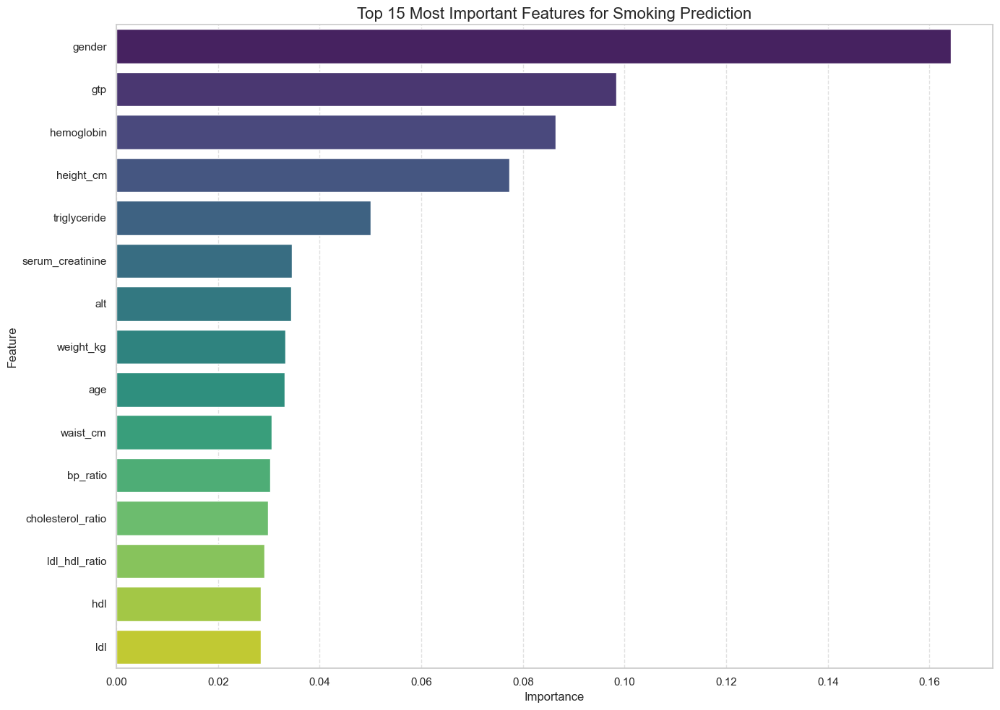

Top 15 Most Important Features:
              Feature  Importance
0              gender    0.164238
21                gtp    0.098348
16         hemoglobin    0.086370
2           height_cm    0.077281
13       triglyceride    0.050094
18   serum_creatinine    0.034538
20                alt    0.034332
3           weight_kg    0.033215
1                 age    0.033055
4            waist_cm    0.030565
25           bp_ratio    0.030238
26  cholesterol_ratio    0.029848
27      ldl_hdl_ratio    0.029199
14                hdl    0.028459
15                ldl    0.028399


In [19]:
# Split features and target
X = df.drop('smoking', axis=1)
y = df['smoking']

# Split data for feature importance analysis
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=RANDOM_STATE, stratify=y)

# Train a Random Forest model for feature importance
rf = RandomForestClassifier(n_estimators=100, max_depth=15, random_state=RANDOM_STATE)
rf.fit(X_train, y_train)

# Get feature importances
importances = rf.feature_importances_
feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Importance': importances
}).sort_values('Importance', ascending=False)

# Plot feature importances
plt.figure(figsize=(14, 10))
sns.barplot(x='Importance', y='Feature', data=feature_importance.head(15), palette='viridis')
plt.title('Top 15 Most Important Features for Smoking Prediction', fontsize=16)
plt.xlabel('Importance', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# Display the top 15 most important features
print("Top 15 Most Important Features:")
print(feature_importance.head(15))

**Insights from Feature Importance Analysis:**

The Random Forest feature importance analysis reveals the most predictive features for smoking status:

1. The top features include many that were also identified through correlation analysis, such as gender, hemoglobin, and height.

2. Liver enzymes (gtp, alt) appear as important predictors, which makes sense as smoking can affect liver function.

3. Some of our engineered features (like cholesterol ratio) appear in the top features, confirming that our feature engineering added value.

4. The importance ranking differs somewhat from pure correlation analysis, indicating that the relationship between these features and smoking status is complex and potentially non-linear.

This analysis helps us identify which features to focus on in our modeling and provides a basis for feature reduction if needed.

## 9. Create and Save Reduced Feature Dataset

Based on our feature importance analysis, let's create a reduced feature set with only the top 15 most important features:

In [20]:
# Get the names of the top 15 features
top_15_features = feature_importance.head(15)['Feature'].tolist()
print("Selected top 15 features for reduced model:")
print(top_15_features)

# Create a reduced dataset with only these features and the target
df_reduced = df[top_15_features + ['smoking']]

# Verify the shape
print(f"\nFull dataset shape: {df.shape}")
print(f"Reduced dataset shape: {df_reduced.shape}")

Selected top 15 features for reduced model:
['gender', 'gtp', 'hemoglobin', 'height_cm', 'triglyceride', 'serum_creatinine', 'alt', 'weight_kg', 'age', 'waist_cm', 'bp_ratio', 'cholesterol_ratio', 'ldl_hdl_ratio', 'hdl', 'ldl']

Full dataset shape: (44084, 30)
Reduced dataset shape: (44084, 16)


## 10. Comprehensive Data Profiling with ydata-profiling

Let's generate a detailed profile of our cleaned dataset to understand all aspects of the data:

In [21]:
try:
    # Create a profile report for the full cleaned dataset
    profile = ProfileReport(df, title="Smoking Prediction Dataset - Full Profile",
                          explorative=True,
                          minimal=False)
    
    # Display the report
    profile.to_notebook_iframe()
    
    # Save the profile report to HTML file for future reference
    profile.to_file("smoking_data_profile_full.html")
    print("Saved full dataset profile to smoking_data_profile_full.html")
    
    # Create a profile report for the reduced dataset
    profile_reduced = ProfileReport(df_reduced, title="Smoking Prediction Dataset - Reduced Profile",
                                  explorative=True,
                                  minimal=False)
    
    # Save the reduced profile report to HTML file
    profile_reduced.to_file("smoking_data_profile_reduced.html")
    print("Saved reduced dataset profile to smoking_data_profile_reduced.html")
    
except Exception as e:
    print(f"Error generating profile report: {str(e)}")
    print("If ydata-profiling is not installed, install it with: pip install ydata-profiling")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


%|          | 0/30 [00:00<?, ?it/s]
%|████▋     | 14/30 [00:00<00:00, 135.44it/s]
100%|██████████| 30/30 [00:00<00:00, 121.18it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Saved full dataset profile to smoking_data_profile_full.html


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 16/16 [00:00<00:00, 173.61it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Saved reduced dataset profile to smoking_data_profile_reduced.html


## 11. Save the Cleaned Datasets

Let's save our full and reduced cleaned datasets for use in subsequent modeling notebooks:

In [22]:
# Save the full cleaned dataset
df.to_csv('smoking_cleaned_full.csv', index=False)
print(f"Saved full cleaned dataset with {df.shape[0]} rows and {df.shape[1]} columns to smoking_cleaned_full.csv")

# Save the reduced feature dataset
df_reduced.to_csv('smoking_cleaned_reduced.csv', index=False)
print(f"Saved reduced feature dataset with {df_reduced.shape[0]} rows and {df_reduced.shape[1]} columns to smoking_cleaned_reduced.csv")

Saved full cleaned dataset with 44084 rows and 30 columns to smoking_cleaned_full.csv
Saved reduced feature dataset with 44084 rows and 16 columns to smoking_cleaned_reduced.csv


## 12. Summary of EDA and Data Cleaning

In this notebook, we performed a comprehensive exploratory data analysis and data cleaning process on the smoking prediction dataset. Here's a summary of our key findings and actions:

### Data Cleaning Steps:
1. **Renamed columns** to more code-friendly format (snake_case)
2. **Encoded categorical variables** (gender, tartar) for use in modeling
3. **Removed unnecessary features** (ID column and 'oral' constant column)
4. **Removed duplicate records** (approximately 20% of the data was duplicated)
5. **Checked for missing values** (none found)
6. **Identified and removed outliers** using the IQR method

### Data Characteristics:
1. **Class Distribution**: Moderate imbalance with ~63% non-smokers vs ~37% smokers
2. **Key Predictors**: Gender, hemoglobin, height, liver enzymes (gtp), triglycerides
3. **Relationships**: Found expected physiological differences between smokers and non-smokers in multiple health metrics

### Feature Engineering:
1. **Created health metrics**: BMI, blood pressure ratio, cholesterol ratios
2. **Added clinical indicators**: Binary hypertension feature
3. **Found new correlations**: Cholesterol ratio showed good correlation with smoking status

### Feature Importance:
1. **Identified top 15 features**: Using Random Forest to determine the most predictive attributes
2. **Created reduced dataset**: Containing only the most important features for efficient modeling

### Outputs Created:
1. **Full cleaned dataset**: All features after cleaning (`smoking_cleaned_full.csv`)
2. **Reduced feature dataset**: Only top 15 features (`smoking_cleaned_reduced.csv`)
3. **Data profile reports**: Comprehensive data documentation for both datasets

These outputs will serve as the foundation for building and evaluating various machine learning models in the subsequent notebooks.